In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px

df_1 = pd.read_csv("https://raw.githubusercontent.com/JBaptisteAll/France_Adventure_Planner/refs/heads/main/forecasts/weather_data_forecast_1day.csv")
df_2 = pd.read_csv("https://raw.githubusercontent.com/JBaptisteAll/France_Adventure_Planner/refs/heads/main/forecasts/weather_data_forecast_2day.csv")
df_3 = pd.read_csv("https://raw.githubusercontent.com/JBaptisteAll/France_Adventure_Planner/refs/heads/main/forecasts/weather_data_forecast_3day.csv")
df_4 = pd.read_csv("https://raw.githubusercontent.com/JBaptisteAll/France_Adventure_Planner/refs/heads/main/forecasts/weather_data_forecast_4day.csv")
df_5 = pd.read_csv("https://raw.githubusercontent.com/JBaptisteAll/France_Adventure_Planner/refs/heads/main/forecasts/weather_data_forecast_5day.csv")

In [2]:
# Ajouter un suffixe aux colonnes
df_1 = df_1.add_suffix('_jour1')
df_2 = df_2.add_suffix('_jour2')
df_3 = df_3.add_suffix('_jour3')
df_4 = df_4.add_suffix('_jour4')
df_5 = df_5.add_suffix('_jour5')

# Combiner les fichiers en un seul DataFrame
all_data = pd.concat([df_1, df_2, df_3, df_4, df_5], axis=1)


In [3]:
# Supprimer les colonnes "Ville" "Latitude" et "Longitude", "Date", "Run_Date" des jours 2 à 5
all_data.drop(columns=['Ville_jour2', 'Latitude_jour2', 'Longitude_jour2', 'Date_jour2', 'Run_Date_jour2',
                       'Ville_jour3', 'Latitude_jour3', 'Longitude_jour3', 'Date_jour3', 'Run_Date_jour3',
                       'Ville_jour4', 'Latitude_jour4', 'Longitude_jour4', 'Date_jour4', 'Run_Date_jour4',
                       'Ville_jour5', 'Latitude_jour5', 'Longitude_jour5', 'Date_jour5', 'Run_Date_jour5'], inplace=True)

all_data.shape

(93200, 40)

c:\Users\j-bal\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


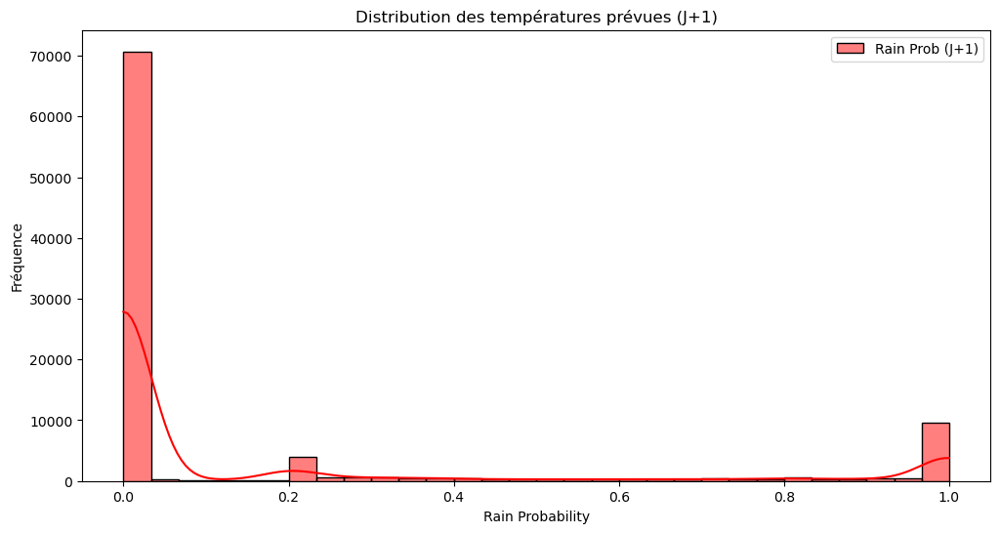

In [4]:
# Visualisation des températures
plt.figure(figsize=(12, 6))
sns.histplot(all_data["Rain_Probability_jour1"], bins=30, kde=True, color="red", label="Rain Prob (J+1)")
plt.xlabel("Rain Probability")
plt.ylabel("Fréquence")
plt.title("Distribution des températures prévues (J+1)")
plt.legend()
plt.show()

In [5]:
# Créer une colonne "Size" pour la taille des points basée sur Temp_Avg
all_data["Size"] = (all_data["Rain_Probability_jour1"] - all_data["Rain_Probability_jour1"].min()) / \
                    (all_data["Rain_Probability_jour1"].max() - all_data["Rain_Probability_jour1"].min()) * 30 + 10

# Création de la carte interactive
fig = px.scatter_mapbox(
    all_data, 
    lat="Latitude_jour1", 
    lon="Longitude_jour1", 
    color="Rain_Probability_jour1", 
    size="Size",  # Taille des points variable
    color_continuous_scale="YlGnBu",  
    hover_name="Ville_jour1",  
    mapbox_style="open-street-map",  
    zoom=3.5,  
    title="Carte Météo : Probabilitée de pluie (J+1)"
)

# Affichage de la carte
fig.show()

In [6]:
# Définir les bornes 
min_RainProb = all_data["Rain_Probability_jour1"].min()
max_RainProb = all_data["Rain_Probability_jour1"].max()

fig = px.density_mapbox(
    all_data,
    lat="Latitude_jour1",
    lon="Longitude_jour1",
    z="Rain_Probability_jour1",
    mapbox_style="open-street-map",
    animation_frame="Date_jour1",  # Animation basée sur la date
    zoom=3.5,
    radius=7,
    color_continuous_scale="YlGnBu",
    center={"lat": 46.603354, "lon": 1.888334},
    range_color=[min_RainProb, max_RainProb]  # Échelle de couleur fixe
)

fig.show()

c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



City with the Highest Rain Probability (Sum)
City : Chamonix
Total Rain Probability : 577.53

 **Top 5 Cities with the Highest Rain Probability** 
   Ville_jour1  Rain_Probability_jour1
17    Chamonix                  577.53
10    Biarritz                  476.24
5       Annecy                  469.49
8      Bayonne                  463.27
16    Chambéry                  457.14


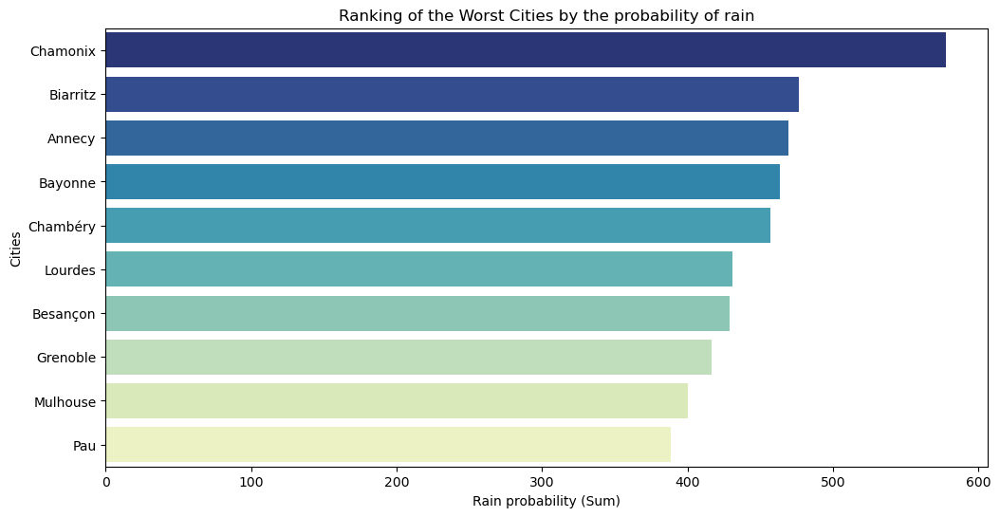

In [7]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Rain_Probability_jour1"].sum().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Rain_Probability_jour1", ascending=False)

# Générer la palette inversée
palette = sns.color_palette("YlGnBu", as_cmap=False, n_colors=10)[::-1]  # ✅ Ici on inverse la liste de couleurs


# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Highest Rain Probability (Sum)")
print(f"City : {best_city['Ville_jour1']}")
print(f"Total Rain Probability : {best_city['Rain_Probability_jour1']}")

print("\n **Top 5 Cities with the Highest Rain Probability** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Rain_Probability_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette=palette
)
plt.xlabel("Rain probability (Sum)")
plt.ylabel("Cities")
plt.title("Ranking of the Worst Cities by the probability of rain")
plt.show()


City with the Lowest Rain Probability (Sum)
City : Marseille
Total Rain Probability : 146.14

 **Top 5 Cities with the Lowest Rain Probability** 
        Ville_jour1  Rain_Probability_jour1
29        Marseille                  146.14
47           Toulon                  154.68
0   Aix-en-Provence                  154.80
39        Perpignan                  157.50
6             Arles                  171.27


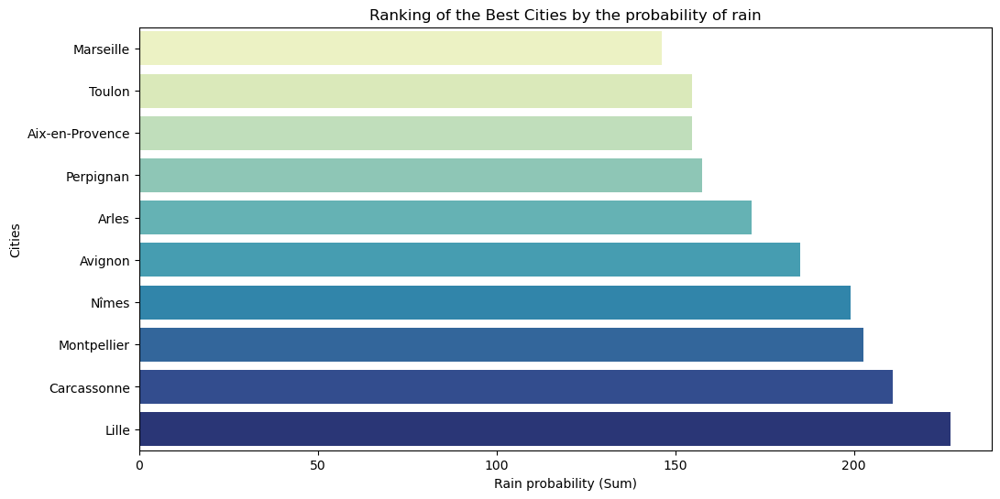

In [8]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Rain_Probability_jour1"].sum().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Rain_Probability_jour1", ascending=True)

# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Lowest Rain Probability (Sum)")
print(f"City : {best_city['Ville_jour1']}")
print(f"Total Rain Probability : {best_city['Rain_Probability_jour1']}")

print("\n **Top 5 Cities with the Lowest Rain Probability** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Rain_Probability_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette="YlGnBu"
)
plt.xlabel("Rain probability (Sum)")
plt.ylabel("Cities")
plt.title("Ranking of the Best Cities by the probability of rain")
plt.show()


In [9]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Rain_Probability_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Rain_Probability_jour1": "sum",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Rain_Probability_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_5_cities = city_ranking.head(5)
    worst_5_cities = city_ranking.tail(5)

    # Afficher le tableau
    display(pd.concat([top_5_cities, worst_5_cities]))

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


,Ville_jour1,Rain_Probability_jour1,Latitude_jour1,Longitude_jour1
17,Chamonix,577.53,45.924670,6.872751
10,Biarritz,476.24,43.483252,-1.559278
5,Annecy,469.49,45.899235,6.128885
8,Bayonne,463.27,43.494514,-1.473666
16,Chambéry,457.14,45.566267,5.920364
6,Arles,171.27,43.677622,4.630965
39,Perpignan,157.50,42.698530,2.895312
0,Aix-en-Provence,154.80,43.529842,5.447474
47,Toulon,154.68,43.125731,5.930492
29,Marseille,146.14,43.296174,5.369953


In [10]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Rain_Probability_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Rain_Probability_jour1": "sum",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Rain_Probability_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_10_cities = city_ranking.head(10).copy()
    worst_10_cities = city_ranking.tail(10).copy()

    # Ajouter une colonne pour différencier les catégories
    top_10_cities["Category"] = "10 Highest Prob"
    worst_10_cities["Category"] = "10 Lowest Prob"

    # Fusionner les deux catégories
    top_worst_cities = pd.concat([top_10_cities, worst_10_cities])

    # Appliquer une taille uniforme pour toutes les villes
    top_worst_cities["Size"] = 5  # Taille fixe pour tous les points

    # Définir une palette de couleurs : Rouge pour le Top 10, Bleu pour le Worst 10
    color_map = {"10 Highest Prob": "blue", "10 Lowest Prob": "red"}

    # Carte interactive des 5 meilleures et 5 pires villes
    fig = px.scatter_mapbox(
        top_worst_cities,
        lat="Latitude_jour1",
        lon="Longitude_jour1",
        color="Category",  
        size="Size",  
        hover_name="Ville_jour1",
        hover_data={"Rain_Probability_jour1": True},
        mapbox_style="open-street-map",
        zoom=3.5,
        color_discrete_map=color_map,
        size_max=10  
    )

    fig.show()

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



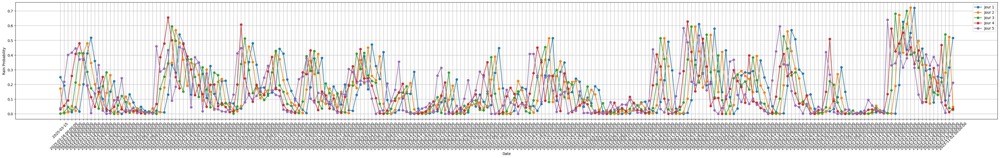

In [11]:
# Regrouper par date et pour chaque jour
Rain_Probability_sum = all_data.groupby("Date_jour1")[
    ["Rain_Probability_jour1", "Rain_Probability_jour2", "Rain_Probability_jour3", "Rain_Probability_jour4", "Rain_Probability_jour5"]
].mean()

# Renommer les colonnes pour plus de clarté
Rain_Probability_sum.columns = ["Jour 1", "Jour 2", "Jour 3", "Jour 4", "Jour 5"]

# Tracer un line plot cumulés par date
plt.figure(figsize=(50, 6))
for column in Rain_Probability_sum.columns:
    plt.plot(Rain_Probability_sum.index, Rain_Probability_sum[column], marker="o", linestyle="-", label=column)

# Ajouter des labels et une légende
plt.xlabel("Date")
plt.ylabel("Rain Probability")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

# Afficher le graphique
plt.show()

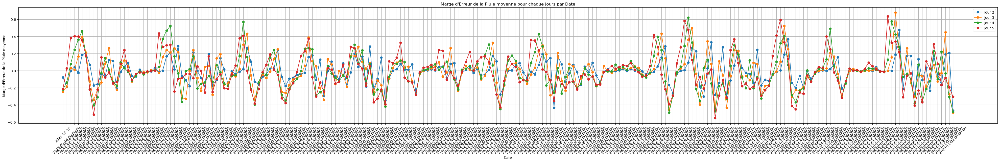

In [12]:
# Calculer la marge d'erreur entre les "jour2" et "jour1"
Rain_Error_Margin1 = (Rain_Probability_sum["Jour 2"] - Rain_Probability_sum["Jour 1"])
Rain_Error_Margin2 = (Rain_Probability_sum["Jour 3"] - Rain_Probability_sum["Jour 1"])
Rain_Error_Margin3 = (Rain_Probability_sum["Jour 4"] - Rain_Probability_sum["Jour 1"])
Rain_Error_Margin4 = (Rain_Probability_sum["Jour 5"] - Rain_Probability_sum["Jour 1"])

# Tracer un line plot de la marge d'erreur Rain_Probability_jour1
plt.figure(figsize=(50, 6))
plt.plot(Rain_Error_Margin1.index, Rain_Error_Margin1, marker="o", linestyle="-")
plt.plot(Rain_Error_Margin2.index, Rain_Error_Margin2, marker="o", linestyle="-")
plt.plot(Rain_Error_Margin3.index, Rain_Error_Margin3, marker="o", linestyle="-")
plt.plot(Rain_Error_Margin4.index, Rain_Error_Margin4, marker="o", linestyle="-")

# Ajouter des labels et un titre
plt.xlabel("Date")
plt.ylabel("Marge d'Erreur de la Pluie moyenne")
plt.title("Marge d'Erreur de la Pluie moyenne pour chaque jours par Date")
plt.xticks(rotation=45)
plt.grid(True)
plt.legend(["Jour 2", "Jour 3", "Jour 4", "Jour 5"])

# Afficher le graphique
plt.show()

# TEMPERATURE

c:\Users\j-bal\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

c:\Users\j-bal\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



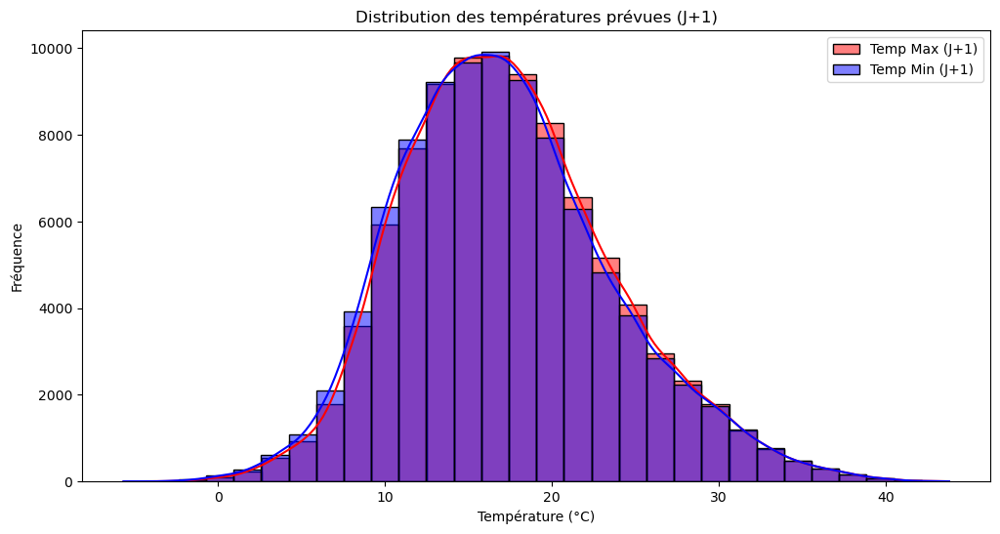

In [13]:
# Visualisation des températures
plt.figure(figsize=(12, 6))
sns.histplot(all_data["Temp_Max_jour1"], bins=30, kde=True, color="red", label="Temp Max (J+1)")
sns.histplot(all_data["Temp_Min_jour1"], bins=30, kde=True, color="blue", label="Temp Min (J+1)")
plt.xlabel("Température (°C)")
plt.ylabel("Fréquence")
plt.title("Distribution des températures prévues (J+1)")
plt.legend()
plt.show()

In [14]:
# Créer une colonne "Size" pour la taille des points basée sur Temp_Avg
all_data["Size"] = (all_data["Temp_Avg_jour1"] - all_data["Temp_Avg_jour1"].min()) / \
                    (all_data["Temp_Avg_jour1"].max() - all_data["Temp_Avg_jour1"].min()) * 30 + 10

# Création de la carte interactive
fig = px.scatter_mapbox(
    all_data, 
    lat="Latitude_jour1", 
    lon="Longitude_jour1", 
    color="Temp_Avg_jour1", 
    size="Size",  # Taille des points variable
    color_continuous_scale="plasma",  
    hover_name="Ville_jour1",  
    hover_data={"Temp_Avg_jour1": True, "Temp_Max_jour1": True, "Temp_Min_jour1": True},  
    mapbox_style="open-street-map",  
    zoom=3.5,  
    title="Carte Météo : Températures Moyennes (J+1)"
)

# Affichage de la carte
fig.show()

In [15]:
# Définir les bornes de température
min_temp = all_data["Temp_Avg_jour1"].min()
max_temp = all_data["Temp_Avg_jour1"].max()

fig = px.density_mapbox(
    all_data,
    lat="Latitude_jour1",
    lon="Longitude_jour1",
    z="Temp_Avg_jour1",  # Influence des données de Temp_Avg
    mapbox_style="open-street-map",
    animation_frame="Date_jour1",  # Animation basée sur la date
    zoom=3.5,
    radius=7,
    color_continuous_scale="thermal",
    center={"lat": 46.603354, "lon": 1.888334},
    labels={"Temp_Avg_jour1": "Average temperature (°C)"},
    range_color=[min_temp, max_temp]  # Échelle de couleur fixe
)

fig.show()

c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



City with the Highest Average Temperature 
City : Perpignan
Average Temperature : 21.085195815450643

 **Top 5 Cities with the Highest Average Temperature** 
   Ville_jour1  Temp_Avg_jour1
39   Perpignan       21.085196
34        Nice       20.943696
47      Toulon       20.442862
7      Avignon       20.305901
35       Nîmes       20.291821


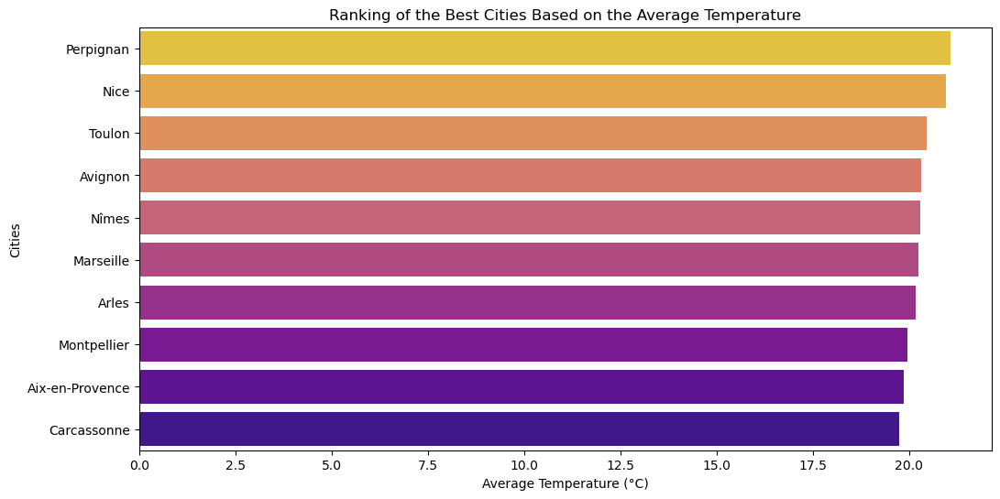

In [16]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Temp_Avg_jour1"].mean().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Temp_Avg_jour1", ascending=False)

# Générer la palette inversée
palette = sns.color_palette("plasma", as_cmap=False, n_colors=10)[::-1]  # ✅ Ici on inverse la liste de couleurs

# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Highest Average Temperature ")
print(f"City : {best_city['Ville_jour1']}")
print(f"Average Temperature : {best_city['Temp_Avg_jour1']}")

print("\n **Top 5 Cities with the Highest Average Temperature** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Temp_Avg_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette=palette
)
plt.xlabel("Average Temperature (°C)")
plt.ylabel("Cities")
plt.title("Ranking of the Best Cities Based on the Average Temperature")
plt.show()


City with the Lowest Average Temperature  
City : Chamonix
Average Temperature : 11.69368025751073

 **Top 5 Cities with the Lowest Average Temperature** 
         Ville_jour1  Temp_Avg_jour1
17          Chamonix       11.693680
12  Boulogne-sur-Mer       14.722505
13             Brest       14.805566
14              Caen       15.121210
44        Saint-Malo       15.232800


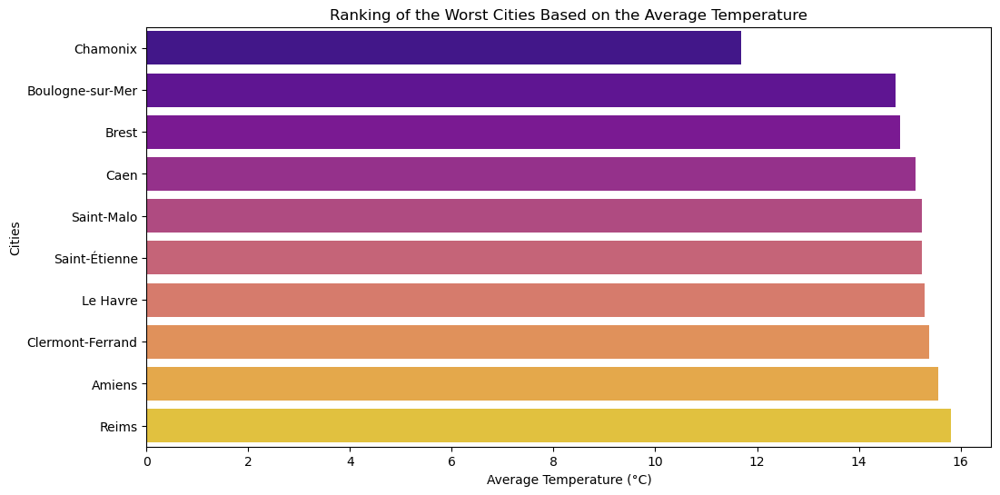

In [17]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Temp_Avg_jour1"].mean().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Temp_Avg_jour1", ascending=True)

# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Lowest Average Temperature  ")
print(f"City : {best_city['Ville_jour1']}")
print(f"Average Temperature : {best_city['Temp_Avg_jour1']}")

print("\n **Top 5 Cities with the Lowest Average Temperature** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Temp_Avg_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette="plasma"
)
plt.xlabel("Average Temperature (°C)")
plt.ylabel("Cities")
plt.title("Ranking of the Worst Cities Based on the Average Temperature")
plt.show()


In [18]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Temp_Avg_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Temp_Avg_jour1": "mean",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Temp_Avg_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_5_cities = city_ranking.head(5)
    worst_5_cities = city_ranking.tail(5)

    # Afficher le tableau
    display(pd.concat([top_5_cities, worst_5_cities]))

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


,Ville_jour1,Temp_Avg_jour1,Latitude_jour1,Longitude_jour1
39,Perpignan,21.085196,42.698530,2.895312
34,Nice,20.943696,43.700936,7.268391
47,Toulon,20.442862,43.125731,5.930492
7,Avignon,20.305901,43.949249,4.805901
35,Nîmes,20.291821,43.837425,4.360069
44,Saint-Malo,15.232800,48.649518,-2.026041
14,Caen,15.121210,49.181340,-0.363561
13,Brest,14.805566,48.390528,-4.486009
12,Boulogne-sur-Mer,14.722505,50.725999,1.611877
17,Chamonix,11.693680,45.924670,6.872751


In [19]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Temp_Avg_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Temp_Avg_jour1": "mean",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Temp_Avg_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_10_cities = city_ranking.head(10).copy()
    worst_10_cities = city_ranking.tail(10).copy()

    # Ajouter une colonne pour différencier les catégories
    top_10_cities["Category"] = "10 Highest Temp"
    worst_10_cities["Category"] = "10 Lowest Temp"

    # Fusionner les deux catégories
    top_worst_cities = pd.concat([top_10_cities, worst_10_cities])

    # Appliquer une taille uniforme pour toutes les villes
    top_worst_cities["Size"] = 5  # Taille fixe pour tous les points

    # Définir une palette de couleurs : Rouge pour le Top 5, Bleu pour le Worst 5
    color_map = {"10 Highest Temp": "red", "10 Lowest Temp": "blue"}

    # Carte interactive des 5 meilleures et 5 pires villes
    fig = px.scatter_mapbox(
        top_worst_cities,
        lat="Latitude_jour1",
        lon="Longitude_jour1",
        color="Category",  
        size="Size",  
        hover_name="Ville_jour1",
        hover_data={"Temp_Avg_jour1": True},
        mapbox_style="open-street-map",
        zoom=3.5,
        color_discrete_map=color_map,
        size_max=10  
    )

    fig.show()

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



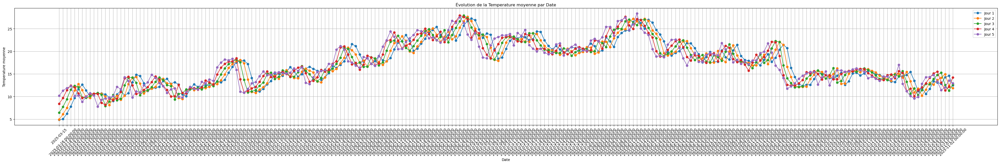

In [20]:
# Regrouper par date et pour chaque jour afficher la température moyenne
Temp_Avg_sum = all_data.groupby("Date_jour1")[
    ["Temp_Avg_jour1", "Temp_Avg_jour2", "Temp_Avg_jour3", "Temp_Avg_jour4", "Temp_Avg_jour5"]
].mean()

# Renommer les colonnes pour plus de clarté
Temp_Avg_sum.columns = ["Jour 1", "Jour 2", "Jour 3", "Jour 4", "Jour 5"]

# Tracer un line plot cumulés par date
plt.figure(figsize=(50, 6))
for column in Temp_Avg_sum.columns:
    plt.plot(Temp_Avg_sum.index, Temp_Avg_sum[column], marker="o", linestyle="-", label=column)

# Ajouter des labels et une légende
plt.xlabel("Date")
plt.ylabel("Temperature moyenne")
plt.title("Évolution de la Temperature moyenne par Date")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

# Afficher le graphique
plt.show()

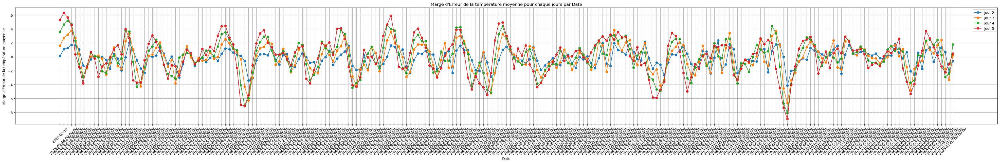

In [21]:
# Calculer la marge d'erreur entre les "weather_scores" "jour2" et "jour1"
Temp_Error_Margin1 = (Temp_Avg_sum["Jour 2"] - Temp_Avg_sum["Jour 1"])
Temp_Error_Margin2 = (Temp_Avg_sum["Jour 3"] - Temp_Avg_sum["Jour 1"])
Temp_Error_Margin3 = (Temp_Avg_sum["Jour 4"] - Temp_Avg_sum["Jour 1"])
Temp_Error_Margin4 = (Temp_Avg_sum["Jour 5"] - Temp_Avg_sum["Jour 1"])

# Tracer un line plot de la marge d'erreur
plt.figure(figsize=(50, 6))
plt.plot(Temp_Error_Margin1.index, Temp_Error_Margin1, marker="o", linestyle="-")
plt.plot(Temp_Error_Margin2.index, Temp_Error_Margin2, marker="o", linestyle="-")
plt.plot(Temp_Error_Margin3.index, Temp_Error_Margin3, marker="o", linestyle="-")
plt.plot(Temp_Error_Margin4.index, Temp_Error_Margin4, marker="o", linestyle="-")

# Ajouter des labels et un titre
plt.xlabel("Date")
plt.ylabel("Marge d'Erreur de la température moyenne")
plt.title("Marge d'Erreur de la température moyenne pour chaque jours par Date")
plt.xticks(rotation=45)
plt.grid(True)
plt.legend(["Jour 2", "Jour 3", "Jour 4", "Jour 5"])

# Afficher le graphique
plt.show()

# WEATHER SCORE

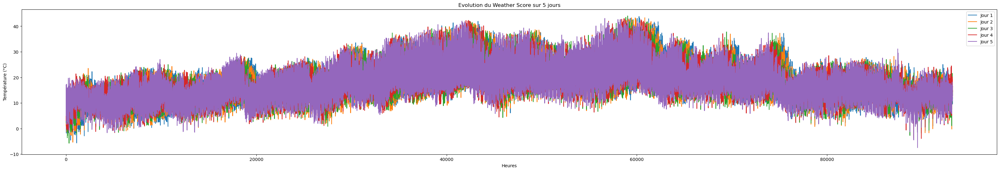

In [22]:
#comparer l'évolution du Weather Score entre les 5 jours
plt.figure(figsize=(40, 6))
plt.plot(all_data['Temp_Avg_jour1'], label='Jour 1')
plt.plot(all_data['Temp_Avg_jour2'], label='Jour 2')
plt.plot(all_data['Temp_Avg_jour3'], label='Jour 3')
plt.plot(all_data['Temp_Avg_jour4'], label='Jour 4')
plt.plot(all_data['Temp_Avg_jour5'], label='Jour 5')
plt.legend()
plt.title("Evolution du Weather Score sur 5 jours")
plt.xlabel("Heures")
plt.ylabel("Température (°C)")
plt.show()


c:\Users\j-bal\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



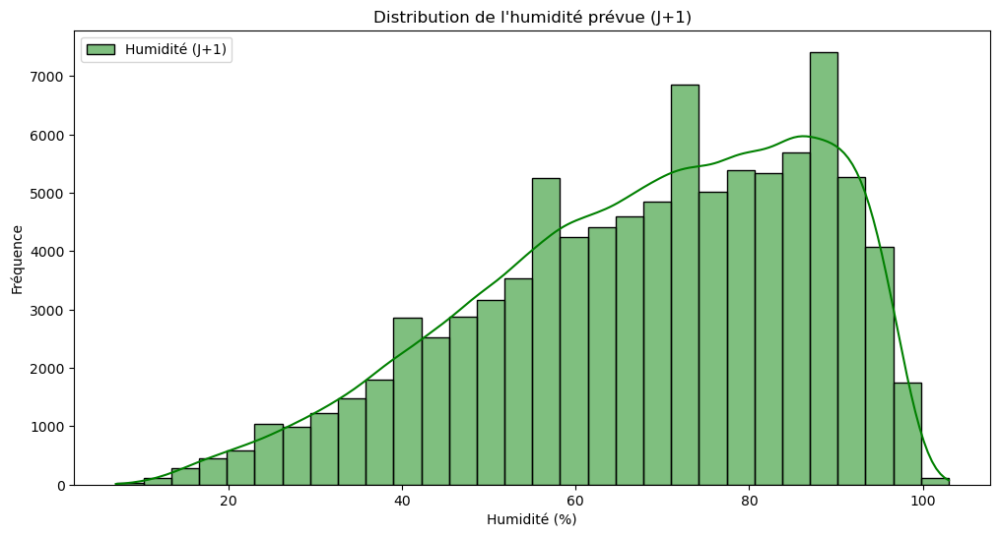

In [23]:
# Visualisation de l'humidité
plt.figure(figsize=(12, 6))
sns.histplot(all_data["Humidity_jour1"], bins=30, kde=True, color="green", label="Humidité (J+1)")
plt.xlabel("Humidité (%)")
plt.ylabel("Fréquence")
plt.title("Distribution de l'humidité prévue (J+1)")
plt.legend()
plt.show()

City with the Most Favorable Cumulative Weather 
City : Marseille
Total Weather Score : 745420

 **Top 5 Cities with the Highest Weather Score** 
        Ville_jour1  Weather_Score_jour1
29        Marseille               745420
47           Toulon               738690
6             Arles               723080
0   Aix-en-Provence               721970
7           Avignon               721730


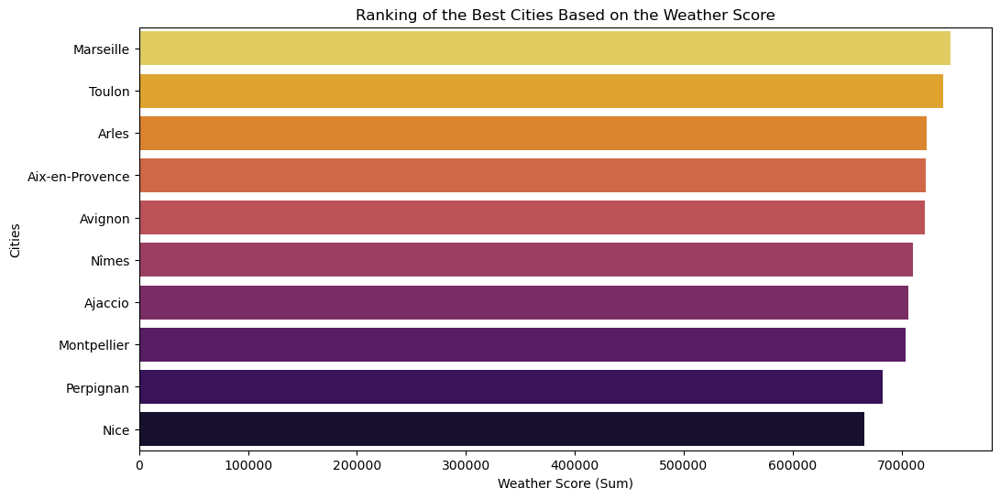

In [24]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Weather_Score_jour1"].sum().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Weather_Score_jour1", ascending=False)

# Générer la palette inversée
palette = sns.color_palette("inferno", as_cmap=False, n_colors=10)[::-1]  # ✅ Ici on inverse la liste de couleurs

# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Most Favorable Cumulative Weather ")
print(f"City : {best_city['Ville_jour1']}")
print(f"Total Weather Score : {best_city['Weather_Score_jour1']}")

print("\n **Top 5 Cities with the Highest Weather Score** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Weather_Score_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette=palette
)
plt.xlabel("Weather Score (Sum)")
plt.ylabel("Cities")
plt.title("Ranking of the Best Cities Based on the Weather Score")
plt.show()


City with the Least Favorable Cumulative Weather 
City : Chamonix
Total Weather Score : 449240

 **Top 5 Cities with the Lowest Weather Score** 
   Ville_jour1  Weather_Score_jour1
17    Chamonix               449240
10    Biarritz               497720
8      Bayonne               500330
27     Lourdes               507460
13       Brest               521280


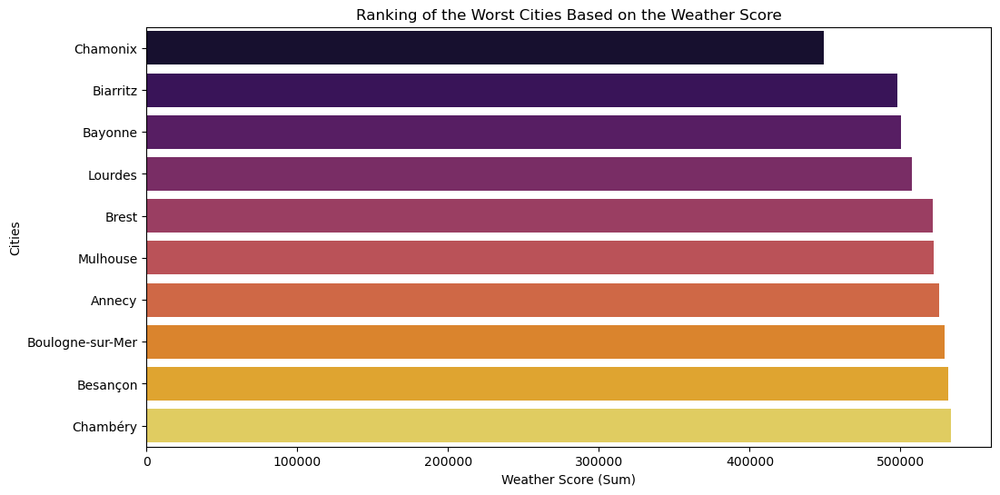

In [25]:
# Calculer le score total pour chaque ville pour le jour 1
city_ranking = all_data.groupby("Ville_jour1")["Weather_Score_jour1"].sum().reset_index()
    
# Trier les villes par meilleur score
city_ranking = city_ranking.sort_values(by="Weather_Score_jour1", ascending=True)

# Trouver la ville avec le meilleur score
best_city = city_ranking.iloc[0]

# Afficher les résultats
print("City with the Least Favorable Cumulative Weather ")
print(f"City : {best_city['Ville_jour1']}")
print(f"Total Weather Score : {best_city['Weather_Score_jour1']}")

print("\n **Top 5 Cities with the Lowest Weather Score** ")
print(city_ranking.head(5))

# Visualisation du classement en barplot
plt.figure(figsize=(12, 6))
sns.barplot(
    x="Weather_Score_jour1", 
    y="Ville_jour1", 
    data=city_ranking.head(10), 
    palette="inferno"
)
plt.xlabel("Weather Score (Sum)")
plt.ylabel("Cities")
plt.title("Ranking of the Worst Cities Based on the Weather Score")
plt.show()


In [26]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Weather_Score_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Weather_Score_jour1": "sum",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Weather_Score_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_5_cities = city_ranking.head(5)
    worst_5_cities = city_ranking.tail(5)

    # Afficher le tableau
    display(pd.concat([top_5_cities, worst_5_cities]))

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


,Ville_jour1,Weather_Score_jour1,Latitude_jour1,Longitude_jour1
29,Marseille,745420,43.296174,5.369953
47,Toulon,738690,43.125731,5.930492
6,Arles,723080,43.677622,4.630965
0,Aix-en-Provence,721970,43.529842,5.447474
7,Avignon,721730,43.949249,4.805901
13,Brest,521280,48.390528,-4.486009
27,Lourdes,507460,43.094090,-0.046497
8,Bayonne,500330,43.494514,-1.473666
10,Biarritz,497720,43.483252,-1.559278
17,Chamonix,449240,45.924670,6.872751


In [27]:
# Vérifier si les colonnes existent
if all(col in all_data.columns for col in ["Weather_Score_jour1", "Latitude_jour1", "Longitude_jour1"]):
    
    # Calculer le score total pour chaque ville pour le jour 1
    city_ranking = all_data.groupby("Ville_jour1", as_index=False).agg({
        "Weather_Score_jour1": "sum",
        "Latitude_jour1": "first",
        "Longitude_jour1": "first"
    })
    
    # Trier les villes par meilleur score
    city_ranking = city_ranking.sort_values(by="Weather_Score_jour1", ascending=False)

    # Sélectionner les 5 meilleures et les 5 pires villes
    top_5_cities = city_ranking.head(10).copy()
    worst_5_cities = city_ranking.tail(10).copy()

    # Ajouter une colonne pour différencier les catégories
    top_5_cities["Category"] = "Top 10"
    worst_5_cities["Category"] = "Worst 10"

    # Fusionner les deux catégories
    top_worst_cities = pd.concat([top_5_cities, worst_5_cities])

    # Appliquer une taille uniforme pour toutes les villes
    top_worst_cities["Size"] = 5  # Taille fixe pour tous les points

    # Définir une palette de couleurs : Rouge pour le Top 5, Bleu pour le Worst 5
    color_map = {"Top 10": "red", "Worst 10": "blue"}

    # Carte interactive des 5 meilleures et 5 pires villes
    fig = px.scatter_mapbox(
        top_worst_cities,
        lat="Latitude_jour1",
        lon="Longitude_jour1",
        color="Category",  
        size="Size",  
        hover_name="Ville_jour1",
        hover_data={"Weather_Score_jour1": True},
        mapbox_style="open-street-map",
        zoom=3.5,
        color_discrete_map=color_map,
        size_max=10  
    )

    fig.show()

else:
    print("Certaines colonnes nécessaires n'existent pas dans le DataFrame.")


c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [28]:
# filtrer les villes du df all_data pour ne garder que les villes de top_5_cities et worst_5_cities
top_flop_df = all_data[all_data["Ville_jour1"].isin(top_worst_cities["Ville_jour1"])]

display(top_flop_df.head())

,Ville_jour1,Latitude_jour1,Longitude_jour1,Date_jour1,Temp_Max_jour1,Temp_Min_jour1,Humidity_jour1,Weather_jour1,Rain_Probability_jour1,Weather_Score_jour1,...,Weather_Score_jour4,Temp_Avg_jour4,Temp_Max_jour5,Temp_Min_jour5,Humidity_jour5,Weather_jour5,Rain_Probability_jour5,Weather_Score_jour5,Temp_Avg_jour5,Size
80,Toulon,43.125731,5.930492,2025-03-15,10.70,10.67,91,broken clouds,0.80,300,...,200,10.29,10.38,10.38,73,overcast clouds,0.0,200,10.38,19.905889
81,Toulon,43.125731,5.930492,2025-03-15,10.44,10.33,89,broken clouds,0.00,300,...,200,10.93,10.04,10.04,75,overcast clouds,0.0,200,10.04,19.723740
82,Toulon,43.125731,5.930492,2025-03-15,10.25,10.25,89,broken clouds,0.00,300,...,200,11.01,10.00,10.00,72,overcast clouds,0.0,200,10.00,19.641773
83,Toulon,43.125731,5.930492,2025-03-15,10.62,10.62,83,light rain,0.47,-10,...,200,12.88,11.05,11.05,65,overcast clouds,0.0,200,11.05,19.866424
84,Toulon,43.125731,5.930492,2025-03-15,11.95,11.95,66,light rain,0.36,-10,...,-10,13.50,12.72,12.72,57,overcast clouds,0.0,200,12.72,20.673953


In [29]:
# voir les villes dans top_flop_df
top_flop_df["Ville_jour1"].unique()

array(['Toulon', 'Nîmes', 'Brest', 'Aix-en-Provence', 'Annecy',
       'Perpignan', 'Besançon', 'Avignon', 'Mulhouse', 'Chambéry',
       'Lourdes', 'Arles', 'Ajaccio', 'Chamonix', 'Nice', 'Marseille',
       'Montpellier', 'Biarritz', 'Bayonne', 'Boulogne-sur-Mer'],
      dtype=object)

In [30]:
top_flop_df.describe()

,Latitude_jour1,Longitude_jour1,Temp_Max_jour1,Temp_Min_jour1,Humidity_jour1,Rain_Probability_jour1,Weather_Score_jour1,Temp_Avg_jour1,Temp_Max_jour2,Temp_Min_jour2,...,Rain_Probability_jour4,Weather_Score_jour4,Temp_Avg_jour4,Temp_Max_jour5,Temp_Min_jour5,Humidity_jour5,Rain_Probability_jour5,Weather_Score_jour5,Temp_Avg_jour5,Size
count,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,...,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000,37280.000000
mean,44.745823,3.982734,18.240022,18.014899,67.730418,0.167553,328.294528,18.127460,18.001388,18.000342,...,0.152536,334.579936,18.153727,18.198564,18.198564,67.608959,0.153477,335.526019,18.198564,24.424688
std,2.200816,3.390537,6.377074,6.435229,18.561711,0.338118,230.283577,6.400606,6.461012,6.460563,...,0.325473,228.700842,6.402040,6.389124,6.389124,18.603014,0.325661,227.890695,6.389124,3.886221
min,41.926399,-4.486009,-5.630000,-5.650000,7.000000,0.000000,-40.000000,-5.630000,-5.350000,-5.350000,...,0.000000,-40.000000,-4.000000,-7.480000,-7.480000,9.000000,0.000000,-40.000000,-7.480000,10.000000
25%,43.436483,2.574453,13.740000,13.450000,55.000000,0.000000,200.000000,13.590000,13.577500,13.577500,...,0.000000,200.000000,13.680000,13.720000,13.720000,55.000000,0.000000,200.000000,13.720000,21.669702
50%,43.689279,5.087927,17.850000,17.600000,69.000000,0.000000,300.000000,17.720000,17.580000,17.580000,...,0.000000,300.000000,17.690000,17.720000,17.720000,69.000000,0.000000,300.000000,17.720000,24.177292
75%,45.905594,6.050493,22.430000,22.180000,83.000000,0.020000,600.000000,22.291250,22.220000,22.220000,...,0.000000,600.000000,22.390000,22.380000,22.380000,83.000000,0.000000,600.000000,22.380000,26.952793
max,50.725999,8.737603,43.120000,43.120000,103.000000,1.000000,600.000000,43.120000,42.240000,42.240000,...,1.000000,600.000000,42.190000,41.560000,41.560000,103.000000,1.000000,600.000000,41.560000,39.599271


In [31]:
# Quelle ville a le plus de clear sky ?
top_flop_df["Weather_jour1"].value_counts()

Weather_jour1
clear sky               10929
light rain               7276
overcast clouds          6255
broken clouds            4841
scattered clouds         4080
few clouds               2882
moderate rain             818
heavy intensity rain       86
light snow                 67
snow                       46
Name: count, dtype: int64

In [32]:
# Compter le nombre de jours avec "clear sky" pour chaque ville
clear_sky_counts = top_flop_df[top_flop_df["Weather_jour1"] == "clear sky"]["Ville_jour1"].value_counts()

# Trouver la ville avec le plus de jours de "clear sky"
most_clear_sky_city = clear_sky_counts.idxmax()
most_clear_sky_count = clear_sky_counts.max()

print(f"La ville avec le plus de jours de 'clear sky' est {most_clear_sky_city} avec {most_clear_sky_count} occurences.")

La ville avec le plus de jours de 'clear sky' est Ajaccio avec 766 occurences.


In [33]:
# compter le nombre de jours avec "snow" pour chaque ville
snow_counts = top_flop_df[top_flop_df["Weather_jour1"] == "snow"]["Ville_jour1"].value_counts()

most_snow_city = snow_counts.idxmax()
most_snow_count = snow_counts.max()

print(f"La ville avec le plus de jours de neige est {most_snow_city} avec {most_snow_count} occurences.")

La ville avec le plus de jours de neige est Chamonix avec 34 occurences.


In [34]:
# Afficher toutes les colonnes
pd.set_option("display.max_columns", None)

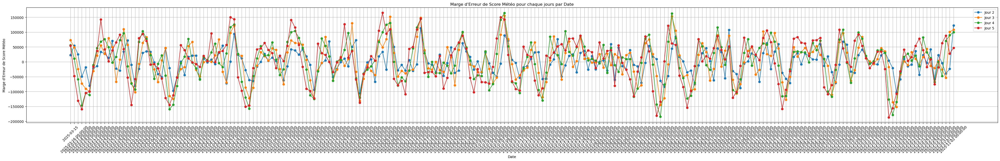

In [35]:
# Regrouper par date et sommer les scores météo pour chaque jour
weather_scores_sum = all_data.groupby("Date_jour1")[
    ["Weather_Score_jour1", "Weather_Score_jour2", "Weather_Score_jour3", "Weather_Score_jour4", "Weather_Score_jour5"]
].sum()

# Renommer les colonnes pour plus de clarté
weather_scores_sum.columns = ["Jour 1", "Jour 2", "Jour 3", "Jour 4", "Jour 5"]


# Calculer la marge d'erreur entre les "weather_scores" "jour2" et "jour1"
Weather_Error_Margin1 = (weather_scores_sum["Jour 2"] - weather_scores_sum["Jour 1"])
Weather_Error_Margin2 = (weather_scores_sum["Jour 3"] - weather_scores_sum["Jour 1"])
Weather_Error_Margin3 = (weather_scores_sum["Jour 4"] - weather_scores_sum["Jour 1"])
Weather_Error_Margin4 = (weather_scores_sum["Jour 5"] - weather_scores_sum["Jour 1"])

# Tracer un line plot de la marge d'erreur
plt.figure(figsize=(50, 6))
plt.plot(Weather_Error_Margin1.index, Weather_Error_Margin1, marker="o", linestyle="-")
plt.plot(Weather_Error_Margin2.index, Weather_Error_Margin2, marker="o", linestyle="-")
plt.plot(Weather_Error_Margin3.index, Weather_Error_Margin3, marker="o", linestyle="-")
plt.plot(Weather_Error_Margin4.index, Weather_Error_Margin4, marker="o", linestyle="-")

# Ajouter des labels et un titre
plt.xlabel("Date")
plt.ylabel("Marge d'Erreur de Score Météo")
plt.title("Marge d'Erreur de Score Météo pour chaque jours par Date")
plt.xticks(rotation=45)
plt.grid(True)
plt.legend(["Jour 2", "Jour 3", "Jour 4", "Jour 5"])

# Afficher le graphique
plt.show()

In [36]:
# Liste des jours à comparer avec la référence (jour 1)
jours_previsions = ["jour2", "jour3", "jour4", "jour5"]

# Calcul des écarts relatifs pour chaque jour de prévision par rapport à jour1
for jour in jours_previsions:
    all_data[f"Temp_Error_{jour}"] = abs(all_data[f"Temp_Avg_{jour}"] - all_data["Temp_Avg_jour1"]) / all_data["Temp_Avg_jour1"]
    all_data[f"Rain_Error_{jour}"] = abs(all_data[f"Rain_Probability_{jour}"] - all_data["Rain_Probability_jour1"])
    all_data[f"Weather_Score_Error_{jour}"] = abs(all_data[f"Weather_Score_{jour}"] - all_data["Weather_Score_jour1"]) / 600

# Score d'accuracy basé sur les écarts
for jour in jours_previsions:
    all_data[f"Accuracy_{jour}"] = 100 - (
        (all_data[f"Temp_Error_{jour}"] * 40) + 
        (all_data[f"Rain_Error_{jour}"] * 30) + 
        (all_data[f"Weather_Score_Error_{jour}"] * 30)
    )

# Normalisation du score pour qu'il reste entre 0 et 100
for jour in jours_previsions:
    all_data[f"Accuracy_{jour}"] = all_data[f"Accuracy_{jour}"].clip(0, 100)

# Affichage des résultats
all_data[["Ville_jour1", "Date_jour1"] + [f"Accuracy_{jour}" for jour in jours_previsions]].head()


,Ville_jour1,Date_jour1,Accuracy_jour2,Accuracy_jour3,Accuracy_jour4,Accuracy_jour5
0,Paris,2025-03-15,73.867028,62.259159,71.289009,28.080054
1,Paris,2025-03-15,81.765286,69.783037,59.526627,4.773176
2,Paris,2025-03-15,57.500000,15.000000,6.785714,0.000000
3,Paris,2025-03-15,75.113636,58.750000,61.818182,13.977273
4,Paris,2025-03-15,81.631579,70.578947,66.210526,49.736842


In [37]:
# regrouper pour chaque ville
city_accuracy = all_data.groupby("Ville_jour1")[[f"Accuracy_{jour}" for jour in jours_previsions]].mean()

# Afficher les résultats
display(city_accuracy)

,Accuracy_jour2,Accuracy_jour3,Accuracy_jour4,Accuracy_jour5
Ville_jour1,,,,
Aix-en-Provence,81.301240,78.372675,77.211845,76.762029
Ajaccio,82.001811,79.235093,78.872031,77.933755
Albi,77.960126,75.076162,72.974465,72.161110
Amiens,79.002679,75.648294,73.986992,72.515345
Angers,79.471522,75.505858,73.857090,73.903655
Annecy,75.816268,70.629335,67.801611,66.426624
Arles,82.223838,79.810995,78.688242,78.100609
Avignon,82.313603,79.485248,78.045572,77.152254
Bayonne,76.361581,72.092375,70.696527,68.906660


In [38]:
# Calculer la moyenne des scores d'accuracy pour chaque ville et garder les latitudes et longitudes
city_accuracy = all_data.groupby("Ville_jour1")[[f"Accuracy_{jour}" for jour in jours_previsions]].mean().reset_index()

# Calculer la moyenne des scores d'accuracy pour chaque ville
city_accuracy["Mean_Accuracy"] = city_accuracy[[f"Accuracy_{jour}" for jour in jours_previsions]].mean(axis=1)

# Trier les villes par la moyenne des scores d'accuracy
city_accuracy = city_accuracy.sort_values(by="Mean_Accuracy", ascending=False)

# Afficher les résultats
display(city_accuracy)

,Ville_jour1,Accuracy_jour2,Accuracy_jour3,Accuracy_jour4,Accuracy_jour5,Mean_Accuracy
47,Toulon,83.194439,80.193838,79.684452,79.074423,80.536788
39,Perpignan,83.714790,79.743768,79.401545,78.895149,80.438813
29,Marseille,82.510203,79.923181,79.243935,78.635622,80.078235
6,Arles,82.223838,79.810995,78.688242,78.100609,79.705921
1,Ajaccio,82.001811,79.235093,78.872031,77.933755,79.510672
31,Montpellier,82.038014,79.732793,77.787504,77.932462,79.372693
7,Avignon,82.313603,79.485248,78.045572,77.152254,79.249169
35,Nîmes,81.315402,79.174820,77.874697,77.101253,78.866543
0,Aix-en-Provence,81.301240,78.372675,77.211845,76.762029,78.411947
34,Nice,81.060109,78.356251,76.909158,76.548715,78.218558


In [39]:
# incorporer le score d'accuracy dans le DataFrame
city_accuracy = pd.merge(city_accuracy, all_data[["Ville_jour1", "Latitude_jour1", "Longitude_jour1"]], on="Ville_jour1")

# Drop duplicates
city_accuracy = city_accuracy.drop_duplicates(subset=["Ville_jour1"])

# Afficher les résultats
display(city_accuracy)

,Ville_jour1,Accuracy_jour2,Accuracy_jour3,Accuracy_jour4,Accuracy_jour5,Mean_Accuracy,Latitude_jour1,Longitude_jour1
0,Toulon,83.194439,80.193838,79.684452,79.074423,80.536788,43.125731,5.930492
1864,Perpignan,83.714790,79.743768,79.401545,78.895149,80.438813,42.698530,2.895312
3728,Marseille,82.510203,79.923181,79.243935,78.635622,80.078235,43.296174,5.369953
5592,Arles,82.223838,79.810995,78.688242,78.100609,79.705921,43.677622,4.630965
7456,Ajaccio,82.001811,79.235093,78.872031,77.933755,79.510672,41.926399,8.737603
9320,Montpellier,82.038014,79.732793,77.787504,77.932462,79.372693,43.611242,3.876734
11184,Avignon,82.313603,79.485248,78.045572,77.152254,79.249169,43.949249,4.805901
13048,Nîmes,81.315402,79.174820,77.874697,77.101253,78.866543,43.837425,4.360069
14912,Aix-en-Provence,81.301240,78.372675,77.211845,76.762029,78.411947,43.529842,5.447474
16776,Nice,81.060109,78.356251,76.909158,76.548715,78.218558,43.700936,7.268391


In [40]:
# Visualiser les 10 meilleures et 10 pires villes sur une carte
top_25_cities = city_accuracy.head(25).copy()
#middle_50_cities = city_accuracy.iloc[20:-20].copy()
worst_25_cities = city_accuracy.tail(25).copy()

# Ajouter une colonne pour différencier les catégories
top_25_cities["Category"] = "Top 25"
worst_25_cities["Category"] = "Worst 25"

# Fusionner les deux catégories
top_worst_cities = pd.concat([top_25_cities,  worst_25_cities])

# Appliquer une taille uniforme pour toutes les villes
top_worst_cities["Size"] = 5  # Taille fixe pour tous les points

# Définir une palette de couleurs : Rouge pour le Top 10, Bleu pour le Worst 10
color_map = {"Top 25": "red", "Worst 25": "blue"}

# Carte interactive des 10 meilleures et 10 pires villes
fig = px.scatter_mapbox(
    top_worst_cities,
    lat="Latitude_jour1",
    lon="Longitude_jour1",
    color="Category",  
    size="Size",  
    hover_name="Ville_jour1",
    hover_data={"Mean_Accuracy": True},
    mapbox_style="open-street-map",
    zoom=3.5,
    color_discrete_map=color_map,
    size_max=10  
)

fig.show()

c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [52]:
# Visualiser les 10 meilleures et 10 pires villes sur une carte
top_10_cities = city_accuracy.head(10).copy()
first_10_cities = city_accuracy.iloc[10:21].copy()
second_10_cities = city_accuracy.iloc[20:31].copy()
third_10_cities = city_accuracy.iloc[30:41].copy()
worst_10_cities = city_accuracy.tail(10).copy()

# Ajouter une colonne pour différencier les catégories
top_10_cities["Category"] = "Top 10"
first_10_cities["Category"] = "10 - 20"
second_10_cities["Category"] = "20 - 30"
third_10_cities["Category"] = "30 - 40"
worst_10_cities["Category"] = "40 - 50"

# Fusionner les deux catégories
top_worst_cities_full = pd.concat([top_10_cities, first_10_cities, second_10_cities, third_10_cities, worst_10_cities])

# Appliquer une taille uniforme pour toutes les villes
top_worst_cities_full["Size"] = 5  # Taille fixe pour tous les points

# Définir une palette de couleurs : Rouge pour le Top 10, Bleu pour le Worst 10
color_map_full = {"Top 10": "red", "10 - 20": "orange", "20 - 30": "green", "30 - 40": "yellow", "40 - 50": "blue"}

# Carte interactive des 10 meilleures et 10 pires villes
fig = px.scatter_mapbox(
    top_worst_cities_full,
    lat="Latitude_jour1",
    lon="Longitude_jour1",
    color="Category",  
    size="Size",  
    hover_name="Ville_jour1",
    hover_data={"Mean_Accuracy": True},
    mapbox_style="open-street-map",
    zoom=3.5,
    color_discrete_map=color_map_full,
    size_max=10  
)

fig.show()

c:\Users\j-bal\anaconda3\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



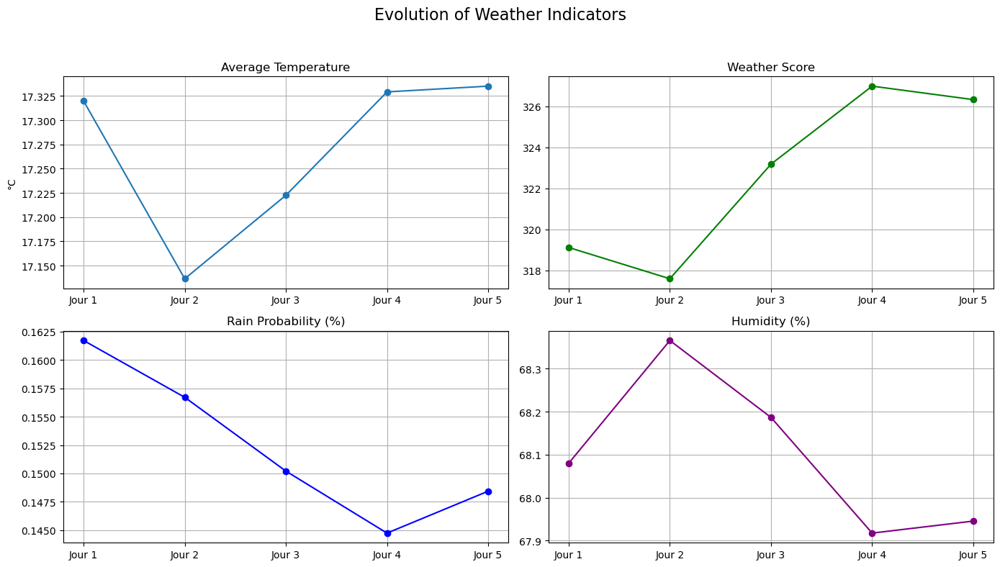

In [41]:
# 1. Moyennes par jour pour chaque indicateur
Temp_Avg = {
    "Jour 1": all_data["Temp_Avg_jour1"].mean(),
    "Jour 2": all_data["Temp_Avg_jour2"].mean(),
    "Jour 3": all_data["Temp_Avg_jour3"].mean(),
    "Jour 4": all_data["Temp_Avg_jour4"].mean(),
    "Jour 5": all_data["Temp_Avg_jour5"].mean(),
}

Score_Meteo = {
    "Jour 1": all_data["Weather_Score_jour1"].mean(),
    "Jour 2": all_data["Weather_Score_jour2"].mean(),
    "Jour 3": all_data["Weather_Score_jour3"].mean(),
    "Jour 4": all_data["Weather_Score_jour4"].mean(),
    "Jour 5": all_data["Weather_Score_jour5"].mean(),
}

Rain_Prob = {
    "Jour 1": all_data["Rain_Probability_jour1"].mean(),
    "Jour 2": all_data["Rain_Probability_jour2"].mean(),
    "Jour 3": all_data["Rain_Probability_jour3"].mean(),
    "Jour 4": all_data["Rain_Probability_jour4"].mean(),
    "Jour 5": all_data["Rain_Probability_jour5"].mean(),
}

Humidity = {
    "Jour 1": all_data["Humidity_jour1"].mean(),
    "Jour 2": all_data["Humidity_jour2"].mean(),
    "Jour 3": all_data["Humidity_jour3"].mean(),
    "Jour 4": all_data["Humidity_jour4"].mean(),
    "Jour 5": all_data["Humidity_jour5"].mean(),
}

# 2. Créer les subplots
fig, axs = plt.subplots(2, 2, figsize=(14, 8))
fig.suptitle("Evolution of Weather Indicators", fontsize=16)

# Température
axs[0, 0].plot(list(Temp_Avg.keys()), list(Temp_Avg.values()), marker="o")
axs[0, 0].set_title("Average Temperature")
axs[0, 0].set_ylabel("°C")
axs[0, 0].grid(True)

# Score météo
axs[0, 1].plot(list(Score_Meteo.keys()), list(Score_Meteo.values()), marker="o", color="green")
axs[0, 1].set_title("Weather Score")
axs[0, 1].grid(True)

# Probabilité de pluie
axs[1, 0].plot(list(Rain_Prob.keys()), list(Rain_Prob.values()), marker="o", color="blue")
axs[1, 0].set_title("Rain Probability (%)")
axs[1, 0].grid(True)

# Humidité
axs[1, 1].plot(list(Humidity.keys()), list(Humidity.values()), marker="o", color="purple")
axs[1, 1].set_title("Humidity (%)")
axs[1, 1].grid(True)

# 3. Ajuster l'espacement
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()
